<a href="https://github.com/RaymondWKWong/Seeing-the-Unseen/blob/main/FlawSizeClassification/FlawSizeClassification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open in Colab"/></a>

In [ ]:
pip install -U keras-tuner

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
import tensorflow_datasets as tfds
import os
import tempfile
import cv2
import glob
from sklearn.datasets import make_classification
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
tmpdir = tempfile.mkdtemp()
from tensorflow import keras
tfds.disable_progress_bar()
from tensorflow.keras import layers
#from tensorflow.keras.preprocessing.image import ImageDataGenerator

from tensorflow.keras.layers import Dense, Conv2D, Activation, Flatten, MaxPooling2D, Dropout
from kerastuner.tuners import RandomSearch
from kerastuner.engine.hyperparameters import HyperParameters
from skimage import io
from keras.models import load_model
from keras.preprocessing import image

from tqdm import tqdm
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, roc_auc_score

from sklearn.multiclass import OneVsRestClassifier
from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from itertools import cycle
import datetime
from tensorflow.keras.callbacks import TensorBoard
from skimage.util import random_noise
from sklearn import preprocessing

# Data Preperation

In [ ]:
batch_size = 32
img_height = 256
img_width = 256
img_size = 256

In [ ]:
train_ds = tf.keras.preprocessing.image_dataset_from_directory(
  '/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/Training',
  labels = 'inferred',
  validation_split = 0.2,
  subset = "training",
  class_names = ['NoFlaw', 'Flaw1mm', 'Flaw3mm', 'Flaw5mm', 'Flaw10mm'],
  seed=123,
  image_size=(img_height, img_width),
  shuffle = True,
  batch_size=batch_size)

val_ds = tf.keras.preprocessing.image_dataset_from_directory(
  '/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/Training',
  labels = 'inferred',
  validation_split = 0.2,
  subset = "validation",
  class_names = ['NoFlaw', 'Flaw1mm', 'Flaw3mm', 'Flaw5mm', 'Flaw10mm'],
  seed=123,
  image_size=(img_height, img_width),
  shuffle = True,
  batch_size=batch_size)

Found 2279 files belonging to 5 classes.
Using 1824 files for training.
Found 2279 files belonging to 5 classes.
Using 455 files for validation.


In [ ]:
for image, label in train_ds.take(1):
  print("Image shape: ", image.numpy().shape)
  print("Label: ", label.numpy())

Image shape:  (32, 256, 256, 3)
Label:  [0 3 4 0 3 0 0 0 1 0 0 0 3 4 3 0 1 3 0 4 0 2 0 0 2 1 0 3 4 2 0 0]


In [ ]:
# Class names from training dataset

class_names = train_ds.class_names
print(class_names)

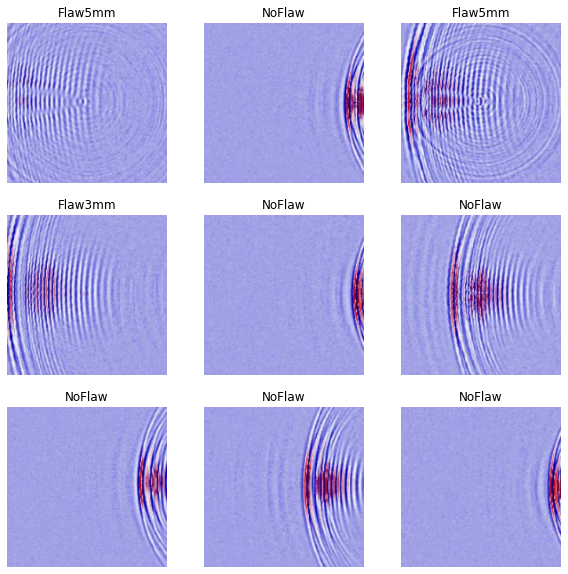

In [ ]:
# Check first 9 images from dataset

plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

In [ ]:
# Normalising data

normalization_layer = tf.keras.layers.experimental.preprocessing.Rescaling(1./255)

normalized_ds = train_ds.map(lambda x, y: (normalization_layer(x), y))
image_batch, labels_batch = next(iter(normalized_ds))
first_image = image_batch[0]
# Notice the pixels values are now in `[0,1]`.
print(np.min(first_image), np.max(first_image))

0.016712623 1.0


In [ ]:
# Configure the dataset

AUTOTUNE = tf.data.AUTOTUNE

train_ds = train_ds.cache().prefetch(buffer_size=AUTOTUNE)
val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)

# Train Model

In [ ]:
def build_model(hp):
  model = keras.models.Sequential()

  model.add(Conv2D(hp.Int("input_units", min_value=32, max_value=256, step=32), kernel_size=(3, 3), input_shape=(img_size,img_size,3)))
  model.add(Activation('relu'))
  model.add(MaxPooling2D(pool_size=(2, 2)))

  for i in range(hp.Int("number_layers", 4, 5, 1)):
    model.add(Conv2D(hp.Int(f"conv_{i}_units", min_value=32, max_value=256, step=32), (3, 3)))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=(2, 2))) # TEST THIS
    model.add(Dropout(0.2))

  model.add(Flatten())  # this converts our 3D feature maps to 1D feature vectors

  model.add(Dense(5))
  model.add(Activation("softmax"))

  model.compile(optimizer="adam",
                loss="sparse_categorical_crossentropy",
                metrics=["accuracy"])
    
  return model

tuner = RandomSearch(
      build_model,
      objective='val_accuracy',
      max_trials=10,
      executions_per_trial=10
)

tensorboard_callback =  [TensorBoard(log_dir=log_folder,
                                     histogram_freq=1,
                                     write_graph=True,
                                     write_images=True,
                                     update_freq='epoch',
                                     profile_batch=2,
                                     embeddings_freq=1)]

tuner.search(train_ds, validation_data=(val_ds), epochs=20, batch_size=64, callbacks=[tensorboard_callback])

Trial 9 Complete [00h 35m 12s]
val_accuracy: 0.8010989129543304

Best val_accuracy So Far: 0.9349450588226318
Total elapsed time: 04h 31m 19s
INFO:tensorflow:Oracle triggered exit


In [ ]:
!rm -rf /logs/
%load_ext tensorboard
log_folder = 'logs'
log_folder = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")

In [ ]:
%tensorboard --logdir logs/fit

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
# ALT

def build_model(hp):
  model = keras.models.Sequential()

  model.add(Conv2D(256, kernel_size=(3, 3), input_shape=(img_size,img_size,3)))
  model.add(Activation('relu'))
  model.add(MaxPooling2D(pool_size=(2, 2)))

  model.add(Conv2D(128, (3, 3)))
  model.add(Activation('relu'))
  model.add(MaxPooling2D(pool_size=(2, 2)))
  model.add(Dropout(0.2))

  model.add(Conv2D(160, (3, 3)))
  model.add(Activation('relu'))
  model.add(MaxPooling2D(pool_size=(2, 2)))
  model.add(Dropout(0.2))

  model.add(Conv2D(256, (3, 3)))
  model.add(Activation('relu'))
  model.add(MaxPooling2D(pool_size=(2, 2)))
  model.add(Dropout(0.2))

  model.add(Conv2D(160, (3, 3)))
  model.add(Activation('relu'))
  model.add(MaxPooling2D(pool_size=(2, 2)))
  model.add(Dropout(0.2))

  model.add(Conv2D(160, (3, 3)))
  model.add(Activation('relu'))
  model.add(MaxPooling2D(pool_size=(2, 2)))
  model.add(Dropout(0.2))

  model.add(Flatten())  # this converts our 3D feature maps to 1D feature vectors

  model.add(Dense(5))
  model.add(Activation("softmax"))

  model.compile(optimizer="adam",
                loss="sparse_categorical_crossentropy",
                metrics=["accuracy"])
    
  return model

tuner = RandomSearch(
      build_model,
      objective='val_accuracy',
      max_trials=32,
      executions_per_trial=20
)

tensorboard_callback =  [TensorBoard(log_dir=log_folder,
                                     histogram_freq=1,
                                     write_graph=True,
                                     write_images=True,
                                     update_freq='epoch',
                                     profile_batch=2,
                                     embeddings_freq=1)]

tuner.search(train_ds, validation_data=(val_ds), epochs=20, batch_size=64, callbacks=[tensorboard_callback]) # EPOCH WAS 20

Trial 1 Complete [01h 07m 39s]
val_accuracy: 0.9054945111274719

Best val_accuracy So Far: 0.9054945111274719
Total elapsed time: 01h 07m 39s
INFO:tensorflow:Oracle triggered exit


In [ ]:
%tensorboard --logdir logs/fit

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
def build_model(hp):
  model = keras.models.Sequential()

  model.add(Conv2D(96, (3, 3)))
  model.add(Activation('relu'))
  model.add(MaxPooling2D(pool_size=(2, 2)))

  model.add(Conv2D(192, (3, 3)))
  model.add(Activation('relu'))
  model.add(Dropout(0.2))

  model.add(Conv2D(160, (3, 3)))
  model.add(Activation('relu'))
  model.add(Dropout(0.2))

  model.add(Conv2D(192, (3, 3)))
  model.add(Activation('relu'))
  model.add(Dropout(0.2))

  model.add(Conv2D(128, (3, 3)))
  model.add(Activation('relu'))
  model.add(Dropout(0.2))

  model.add(Flatten())  # this converts our 3D feature maps to 1D feature vectors

  model.add(Dense(5))
  model.add(Activation("softmax"))

  model.compile(optimizer="adam",
                loss="sparse_categorical_crossentropy",
                metrics=["accuracy"])
    
  return model

tuner = RandomSearch(
      build_model,
      objective='val_accuracy',
      max_trials=32,
      executions_per_trial=3
)

tuner.search(train_ds, validation_data=(val_ds), epochs=32, batch_size=64)

# Retrieve and save model before disconnection

best_model = tuner.get_best_models()[0]
best_model.save('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/flaw_size_classification')

In [ ]:
# Top 10 best model's summary

print(tuner.results_summary())

Results summary
Results in ./untitled_project
Showing 10 best trials
Objective(name='val_accuracy', direction='max')
Trial summary
Hyperparameters:
input_units: 256
number_layers: 4
conv_0_units: 128
conv_1_units: 160
conv_2_units: 256
conv_3_units: 160
conv_4_units: 160
Score: 0.9349450588226318
Trial summary
Hyperparameters:
input_units: 128
number_layers: 5
conv_0_units: 96
conv_1_units: 224
conv_2_units: 192
conv_3_units: 224
conv_4_units: 192
Score: 0.9270329713821411
Trial summary
Hyperparameters:
input_units: 192
number_layers: 5
conv_0_units: 128
conv_1_units: 224
conv_2_units: 256
conv_3_units: 224
conv_4_units: 128
Score: 0.9217582464218139
Trial summary
Hyperparameters:
input_units: 160
number_layers: 4
conv_0_units: 64
conv_1_units: 128
conv_2_units: 160
conv_3_units: 96
conv_4_units: 32
Score: 0.917362642288208
Trial summary
Hyperparameters:
input_units: 192
number_layers: 4
conv_0_units: 192
conv_1_units: 128
conv_2_units: 64
conv_3_units: 160
Score: 0.8881318747997284
Tr

# Summary of Best Performing Model From Hyperparameter Optimisation

In [ ]:
# Retrieves best model

best_model = tuner.get_best_models()[0]

In [ ]:
best_model.evaluate(val_ds)

15/15 [==============================] - 1s 41ms/step - loss: 0.1734 - accuracy: 0.9451


[0.17342394590377808, 0.9450549483299255]

In [ ]:
best_model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 254, 254, 256)     7168      
_________________________________________________________________
activation (Activation)      (None, 254, 254, 256)     0         
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 127, 127, 256)     0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 125, 125, 128)     295040    
_________________________________________________________________
activation_1 (Activation)    (None, 125, 125, 128)     0         
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 62, 62, 128)       0         
_________________________________________________________________
dropout (Dropout)            (None, 62, 62, 128)       0

In [ ]:
tuner.results_summary()

Results summary
Results in ./untitled_project
Showing 10 best trials
Objective(name='val_accuracy', direction='max')
Trial summary
Hyperparameters:
input_units: 256
number_layers: 4
conv_0_units: 128
conv_1_units: 160
conv_2_units: 256
conv_3_units: 160
conv_4_units: 160
Score: 0.9349450588226318
Trial summary
Hyperparameters:
input_units: 128
number_layers: 5
conv_0_units: 96
conv_1_units: 224
conv_2_units: 192
conv_3_units: 224
conv_4_units: 192
Score: 0.9270329713821411
Trial summary
Hyperparameters:
input_units: 192
number_layers: 5
conv_0_units: 128
conv_1_units: 224
conv_2_units: 256
conv_3_units: 224
conv_4_units: 128
Score: 0.9217582464218139
Trial summary
Hyperparameters:
input_units: 160
number_layers: 4
conv_0_units: 64
conv_1_units: 128
conv_2_units: 160
conv_3_units: 96
conv_4_units: 32
Score: 0.917362642288208
Trial summary
Hyperparameters:
input_units: 192
number_layers: 4
conv_0_units: 192
conv_1_units: 128
conv_2_units: 64
conv_3_units: 160
Score: 0.8881318747997284
Tr

# Save Load Models

In [ ]:
# Saves "best" performed model

#best_model = tuner.get_best_models()[0]
best_model.save('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/flaw_size_classification1') # Check number at the back
#best_model.save('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/flaw_size_classification_model')

INFO:tensorflow:Assets written to: /content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/flaw_size_classification1/assets


In [ ]:
# Load model

loaded_model = keras.models.load_model('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/flaw_size_classification1')

In [ ]:
loaded_model.evaluate(val_ds)

15/15 [==============================] - 1s 39ms/step - loss: 0.1734 - accuracy: 0.9451


[0.17342394590377808, 0.9450549483299255]

In [ ]:
folders = glob.glob('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/1mm')
imagenames_list = []
for folder in folders:
    for f in glob.glob(folder+'/*.jpg'):
        imagenames_list.append(f)

read_images = []        
for image in imagenames_list:
    read_images.append(cv2.imread(image, cv2.IMREAD_UNCHANGED))

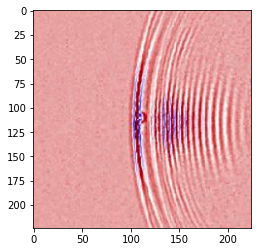

In [ ]:
plt.imshow(read_images[0])

# Predict Flaws With Trained Model

In [ ]:
# Change Class Labels for Title
class_names_title = ['No Flaw', '1mm Flaw', '3mm Flaw', '5mm Flaw', '10mm Flaw'] # CHECK ORDER IF NECESSARY LATER ON !!!!!!!!!!!!!

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:455: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


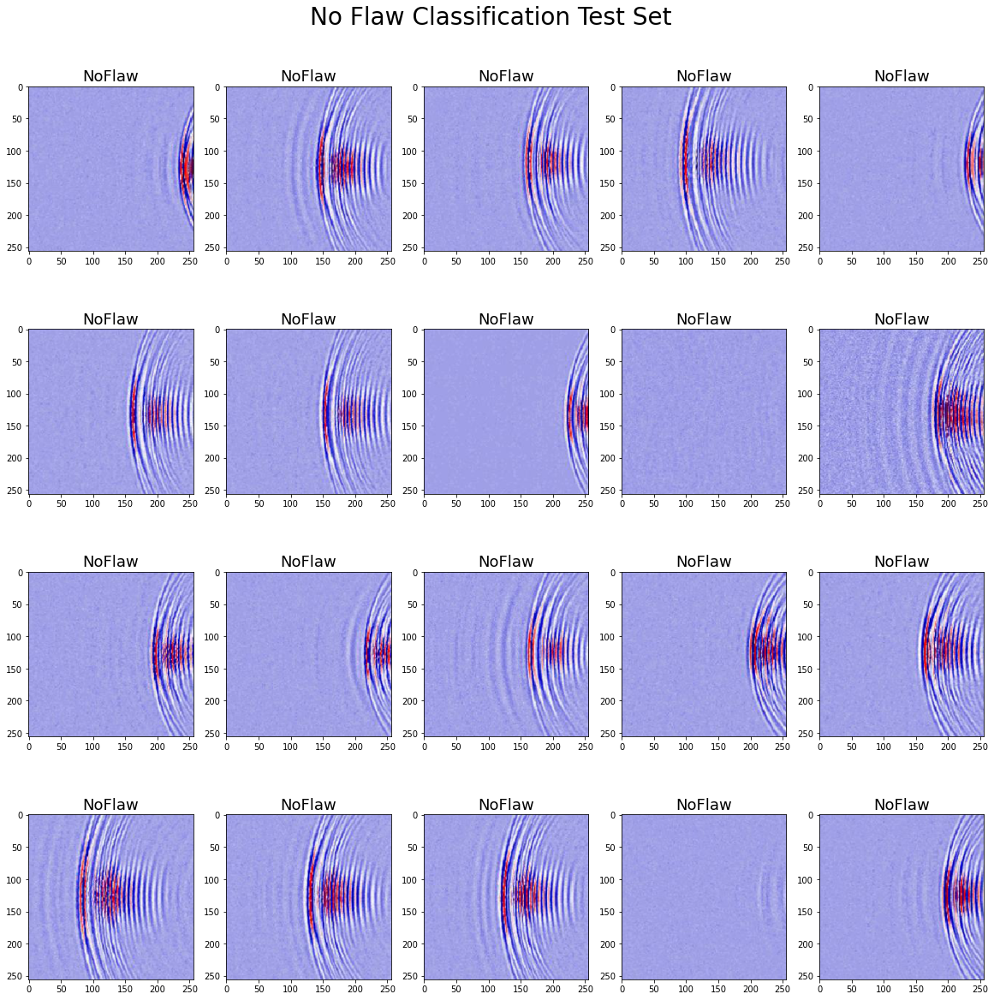



100.0% accuracy


In [ ]:
# No Flaw Classification

n = 0
class_label_predict = class_names_title[n]

batch_holder = np.zeros((20, img_height, img_width, 3))
img_dir='/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/NoFlaw'
for i,img in enumerate(os.listdir(img_dir)):
  img = image.load_img(os.path.join(img_dir,img), target_size=(img_height,img_width))
  batch_holder[i, :] = img

result=loaded_model.predict_classes(batch_holder)

fig = plt.figure(figsize=(20, 20))

for i,img in enumerate(batch_holder):
  fig.add_subplot(4,5, i+1)
  plt.title(class_names[result[i]], fontsize=18)
  plt.suptitle(f"{class_label_predict} Classification Test Set", fontsize=28, ha="center", transform=fig.transFigure, y=0.93)
  plt.imshow(img/256.)
  
plt.show()

# Calculate accuracy
occ = len(result)
counter=0

for i in range(occ):
  if result[i] == n:
    counter += 1

accuracy = (counter/len(result))*100
print('\n')
print(f"{accuracy}% accuracy")

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:455: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


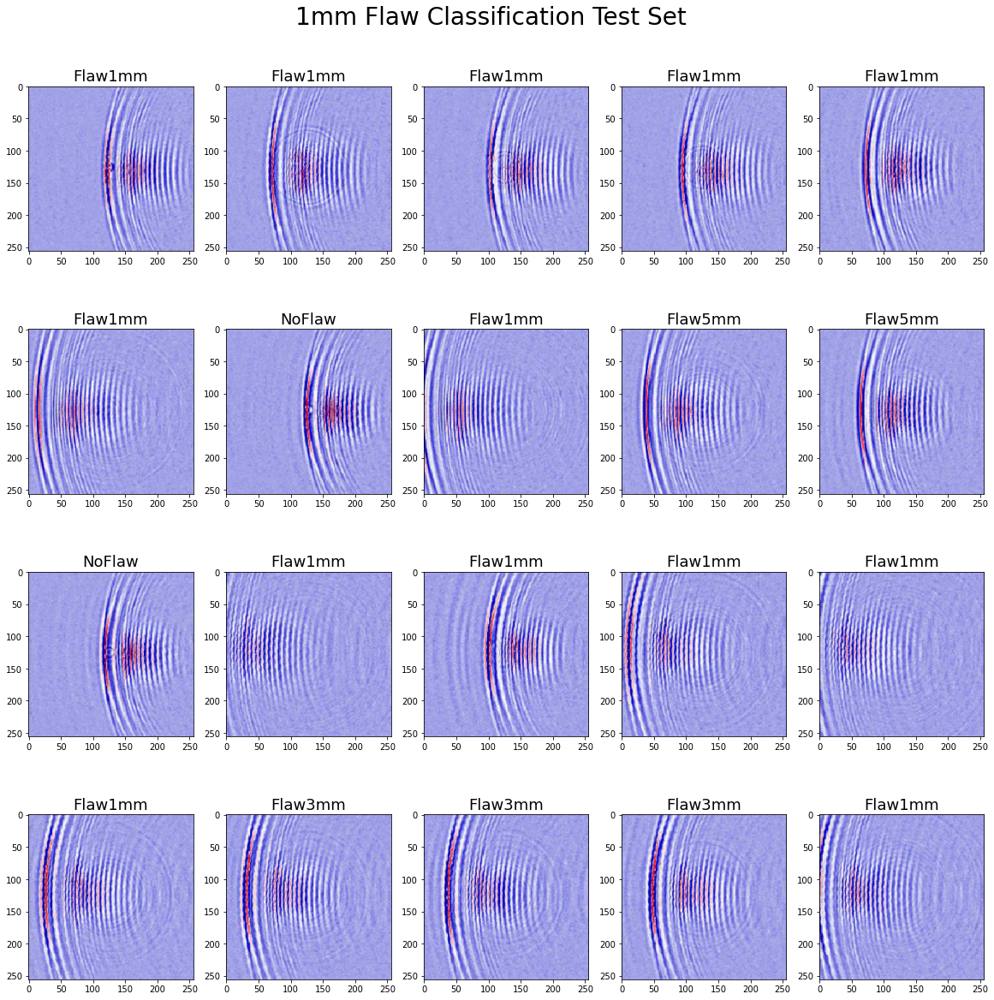



65.0% accuracy


In [ ]:
# 1mm Flaw Classification

n = 1
class_label_predict = class_names_title[n]

batch_holder = np.zeros((20, img_height, img_width, 3))
img_dir='/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/1mm'
for i,img in enumerate(os.listdir(img_dir)):
  img = image.load_img(os.path.join(img_dir,img), target_size=(img_height,img_width))
  batch_holder[i, :] = img

result=loaded_model.predict_classes(batch_holder)

fig = plt.figure(figsize=(20, 20))

for i,img in enumerate(batch_holder):
  fig.add_subplot(4,5, i+1)
  plt.title(class_names[result[i]], fontsize=18)
  plt.suptitle(f"{class_label_predict} Classification Test Set", fontsize=28, ha="center", transform=fig.transFigure, y=0.93)
  plt.imshow(img/256.)
  
plt.show()

# Calculate accuracy
occ = len(result)
counter=0

for i in range(occ):
  if result[i] == n:
    counter += 1

accuracy = (counter/len(result))*100
print('\n')
print(f"{accuracy}% accuracy")

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:455: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


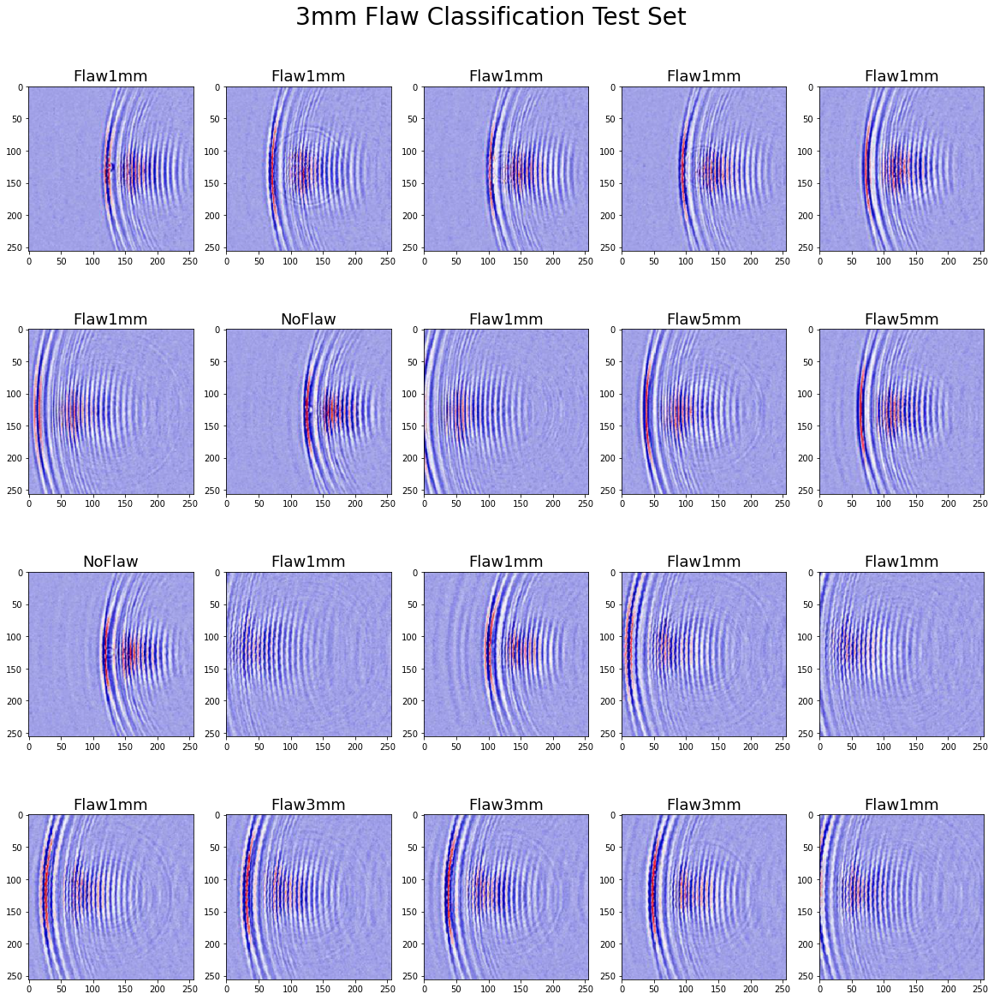



15.0% accuracy


In [ ]:
# 3mm Flaw Classification

n = 2
class_label_predict = class_names_title[n]

batch_holder = np.zeros((20, img_height, img_width, 3))
img_dir='/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/1mm'
for i,img in enumerate(os.listdir(img_dir)):
  img = image.load_img(os.path.join(img_dir,img), target_size=(img_height,img_width))
  batch_holder[i, :] = img

result=loaded_model.predict_classes(batch_holder)

fig = plt.figure(figsize=(20, 20))

for i,img in enumerate(batch_holder):
  fig.add_subplot(4,5, i+1)
  plt.title(class_names[result[i]], fontsize=18)
  plt.suptitle(f"{class_label_predict} Classification Test Set", fontsize=28, ha="center", transform=fig.transFigure, y=0.93)
  plt.imshow(img/256.)
  
plt.show()

# Calculate accuracy
occ = len(result)
counter=0

for i in range(occ):
  if result[i] == n:
    counter += 1

accuracy = (counter/len(result))*100
print('\n')
print(f"{accuracy}% accuracy")

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:455: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


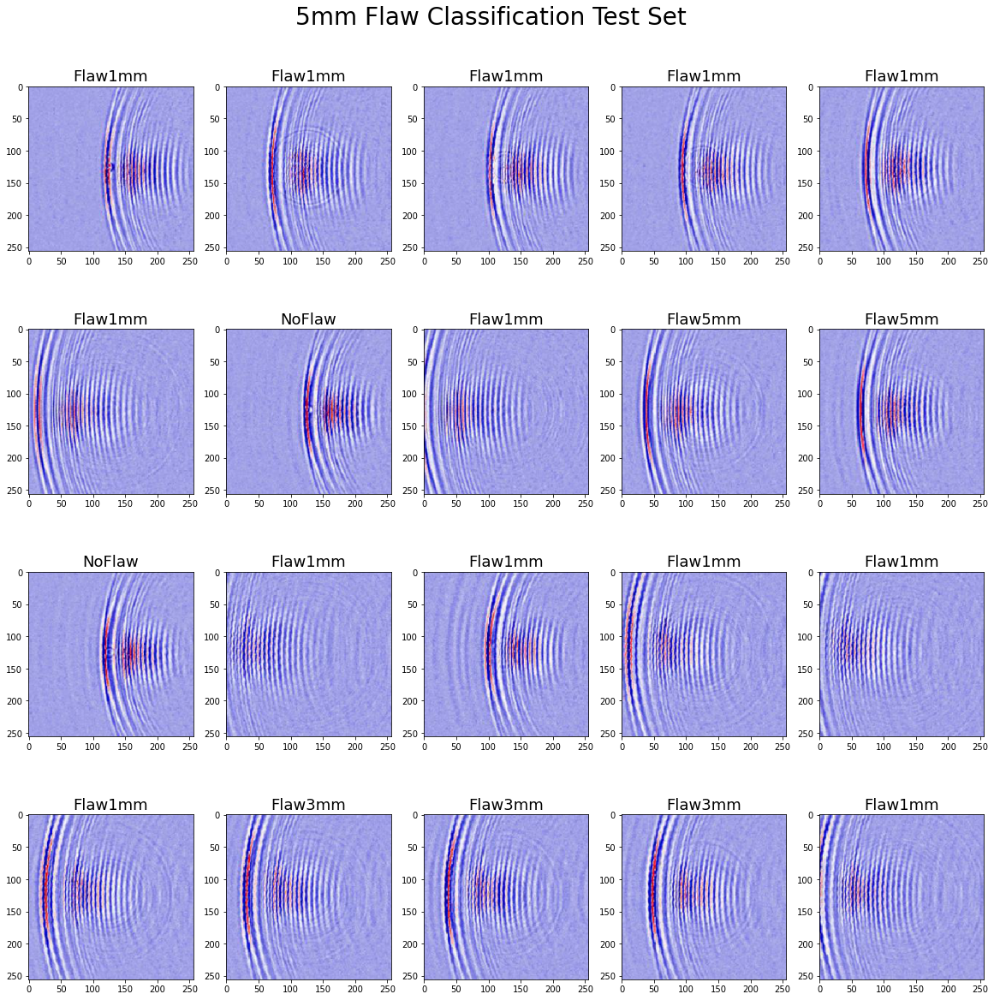



10.0% accuracy


In [ ]:
# 5mm Flaw Classification

n = 3
class_label_predict = class_names_title[n]

batch_holder = np.zeros((20, img_height, img_width, 3))
img_dir='/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/1mm'
for i,img in enumerate(os.listdir(img_dir)):
  img = image.load_img(os.path.join(img_dir,img), target_size=(img_height,img_width))
  batch_holder[i, :] = img

result=loaded_model.predict_classes(batch_holder)

fig = plt.figure(figsize=(20, 20))

for i,img in enumerate(batch_holder):
  fig.add_subplot(4,5, i+1)
  plt.title(class_names[result[i]], fontsize=18)
  plt.suptitle(f"{class_label_predict} Classification Test Set", fontsize=28, ha="center", transform=fig.transFigure, y=0.93)
  plt.imshow(img/256.)
  
plt.show()

# Calculate accuracy
occ = len(result)
counter=0

for i in range(occ):
  if result[i] == n:
    counter += 1

accuracy = (counter/len(result))*100
print('\n')
print(f"{accuracy}% accuracy")

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:455: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


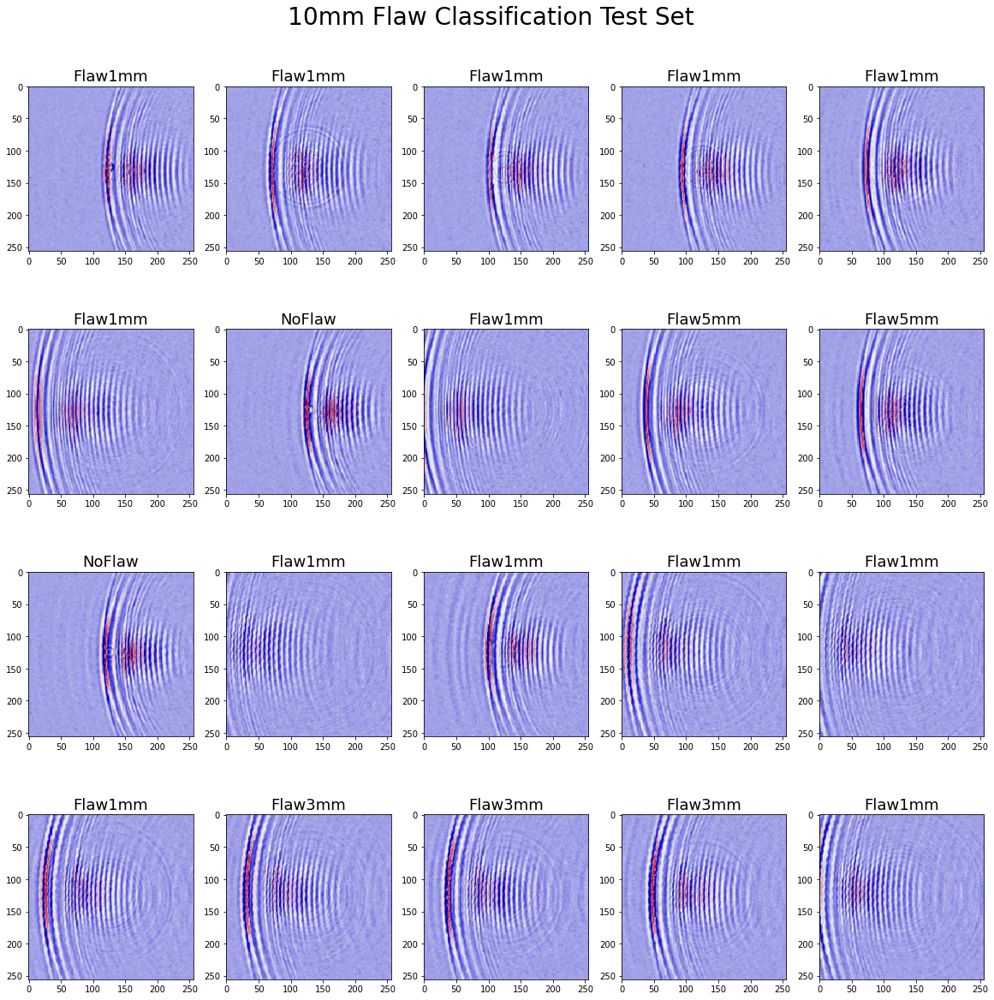



0.0% accuracy


In [ ]:
# 10mm Flaw Classification

n = 4
class_label_predict = class_names_title[n]

batch_holder = np.zeros((20, img_height, img_width, 3))
img_dir='/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/1mm'
for i,img in enumerate(os.listdir(img_dir)):
  img = image.load_img(os.path.join(img_dir,img), target_size=(img_height,img_width))
  batch_holder[i, :] = img

result=loaded_model.predict_classes(batch_holder)

fig = plt.figure(figsize=(20, 20))

for i,img in enumerate(batch_holder):
  fig.add_subplot(4,5, i+1)
  plt.title(class_names[result[i]], fontsize=18)
  plt.suptitle(f"{class_label_predict} Classification Test Set", fontsize=28, ha="center", transform=fig.transFigure, y=0.93)
  plt.imshow(img/256.)
  
plt.show()

# Calculate accuracy
occ = len(result)
counter=0

for i in range(occ):
  if result[i] == n:
    counter += 1

accuracy = (counter/len(result))*100
print('\n')
print(f"{accuracy}% accuracy")

# Data Splitting Test

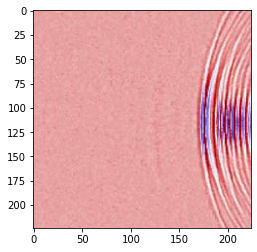

In [ ]:
DATADIR = "/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/Training"

CATEGORIES = ['NoFlaw', 'Flaw1mm', 'Flaw3mm', 'Flaw5mm', 'Flaw10mm']

for category in CATEGORIES: 
    path = os.path.join(DATADIR,category) 
    for img in os.listdir(path): 
        img_array = cv2.imread(os.path.join(path,img) ,cv2.IMREAD_UNCHANGED)
        plt.imshow(img_array) 
        plt.show() 

        break
    break 

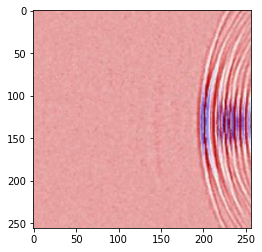

In [ ]:
IMG_SIZE = 256

new_array = cv2.resize(img_array, (IMG_SIZE, IMG_SIZE))
plt.imshow(new_array)
plt.show()

In [ ]:
training_data = []

def create_training_data():
    for category in CATEGORIES:  

        path = os.path.join(DATADIR,category)  # create path to flaw images
        class_num = CATEGORIES.index(category)  # get the classification

        for img in tqdm(os.listdir(path)):  # iterate over each image 
            try:
                img_array = cv2.imread(os.path.join(path,img) ,cv2.IMREAD_UNCHANGED)  # convert to array
                new_array = cv2.resize(img_array, (IMG_SIZE, IMG_SIZE))  # resize to normalize data size
                training_data.append([new_array, class_num])  # add this to our training_data
            except Exception as e:  # in the interest in keeping the output clean...
                pass
            #except OSError as e:
            #    print("OSErrroBad img most likely", e, os.path.join(path,img))
            #except Exception as e:
            #    print("general exception", e, os.path.join(path,img))

create_training_data()

print(len(training_data))

100%|██████████| 133/133 [00:00<00:00, 306.93it/s]

2279


In [ ]:
X = []
Y = []

for features,label in training_data:
    X.append(features)
    Y.append(label)

print(X[0].reshape(-1, IMG_SIZE, IMG_SIZE, 3))

X = np.array(X).reshape(-1, IMG_SIZE, IMG_SIZE, 3)

In [ ]:
# Alternative for above error SAVE

from google.colab import drive
drive.mount('/content/drive')

with open('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/Arrays/X.txt1', 'wb') as f:
    np.save(f, X)

with open('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/Arrays/Y.txt1', 'wb') as f:
    np.save(f, Y)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Alternative for above error LOAD

X = np.load('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/Arrays/X.txt') #loading
Y = np.load('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/Arrays/Y.txt') #loading

In [ ]:
# Binarize the output
from sklearn.preprocessing import label_binarize
y_bin = label_binarize(Y, classes=[0, 1, 2, 3, 4])
n_classes = y_bin.shape[1]

# Data splitting with the binarized output

X_train, X_test, Y_train, Y_test = train_test_split(X, y_bin, test_size=.2,
                                                    random_state=0)

In [ ]:
# Save 

from google.colab import drive
drive.mount('/content/drive')

with open('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/Arrays/X1.txt', 'wb') as f:
    np.save(f, X)

with open('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/Arrays/Y1.txt', 'wb') as f:
    np.save(f, Y)

with open('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/Arrays/X_train.txt', 'wb') as f:
    np.save(f, X_train)

with open('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/Arrays/X_test.txt', 'wb') as f:
    np.save(f, X_test)

with open('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/Arrays/Y_train.txt', 'wb') as f:
    np.save(f, Y_train)

with open('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/Arrays/Y_test.txt', 'wb') as f:
    np.save(f, Y_test)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Load

X = np.load('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/Arrays/X.txt')
Y = np.load('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/Arrays/Y.txt')
X_train = np.load('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/Arrays/X_train.txt')
X_test = np.load('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/Arrays/X_test.txt')
Y_train = np.load('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/Arrays/Y_train.txt')
Y_test = np.load('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/Arrays/Y_test.txt')

In [ ]:
nsamples, nx, ny, chan = X_train.shape
X_Train = X_train.reshape((nsamples,nx*ny*chan))

nsamples, nx, ny, chan = X_test.shape
X_Test = X_test.reshape((nsamples,nx*ny*chan))

In [ ]:
# Data splitting NON BINARIZED - IGNORE UNLESS NEEDED

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=.2,
                                                    random_state=0)

# Prediction Probabilities

In [ ]:
# Train the classifier

from sklearn.multiclass import OneVsRestClassifier
from sklearn import svm, datasets
classifier = OneVsRestClassifier(svm.SVC(kernel='linear', probability=True,
                                 random_state=0))
y_score = classifier.fit(X_Train, Y_train).decision_function(X_Test)

In [ ]:
# Save y_score

from google.colab import drive
drive.mount('/content/drive')

with open('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/Arrays/Y_score_Fin.txt', 'wb') as f:
    np.save(f, y_score)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Load y_score

classifier = OneVsRestClassifier(svm.SVC(kernel='linear', probability=True,
                                 random_state=0))

# y_score = np.load('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/Arrays/y_score1.txt') #loading

y_score = np.load('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/Arrays/Y_score_Fin.txt') #loading

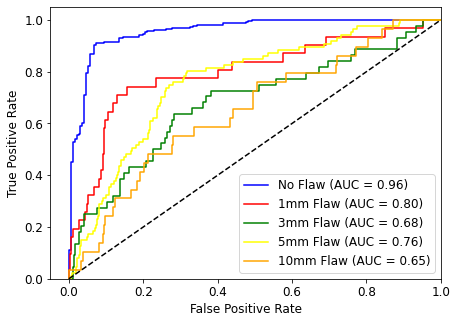

In [ ]:
fpr = dict()
tpr = dict()
thresholds = dict()
roc_auc = dict()
n_tests = Y_test.shape
col = result.shape[0]
n_classes = 5 # Check previous code for auto calc

plt.figure(figsize=(7, 5))
for i in range(n_classes):
  
    fpr[i], tpr[i], thresholds[i] = roc_curve(Y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = cycle(['blue', 'red', 'green', 'yellow', 'orange'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=1.5,
             label=f'{class_names_title[i]} (AUC = {roc_auc[i]:0.2f})'
             ''.format(i, roc_auc[i]))
plt.plot([0, 1], [0, 1], 'k--', lw=1.5)
plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate',fontsize=12)
plt.ylabel('True Positive Rate',fontsize=12)
#plt.title('Receiver operating characteristic for multi-class data')
plt.legend(loc="lower right",fontsize=12)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()

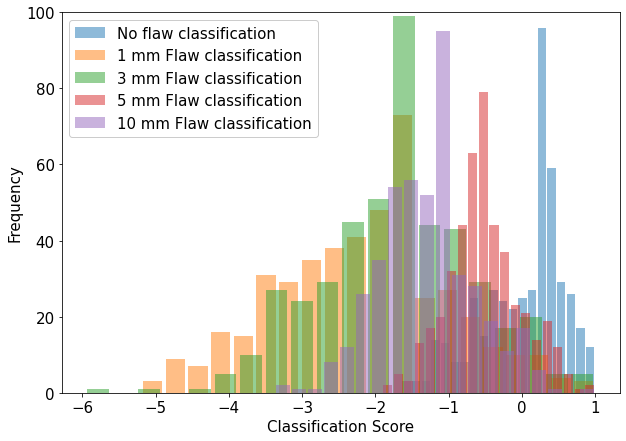

In [ ]:
bins = 20
alpha = 0.5
rwidth = 0.85
f_size = 15

score1 = (np.array(y_score[:,0])).reshape(-1,1)
score1 = preprocessing.normalize(score1, axis=0, norm='max')
score2 = (np.array(y_score[:,1])).reshape(-1,1)
score2 = preprocessing.normalize(score2, axis=0, norm='max')
score3 = (np.array(y_score[:,2])).reshape(-1,1)
score3 = preprocessing.normalize(score3, axis=0, norm='max')
score4 = (np.array(y_score[:,3])).reshape(-1,1)
score4 = preprocessing.normalize(score4, axis=0, norm='max')
score5 = (np.array(y_score[:,4])).reshape(-1,1)
score5 = preprocessing.normalize(score5, axis=0, norm='max')

y_hist1 = score1[:,0]
y_hist2 = score2[:,0]
y_hist3 = score3[:,0]
y_hist4 = score4[:,0]
y_hist5 = score5[:,0]

plt.figure(figsize=(10,7))
plt.hist(y_hist1, bins, rwidth=rwidth, alpha=alpha, label = 'No flaw classification')
plt.hist(y_hist2, bins, rwidth=rwidth, alpha=alpha, label = '1 mm Flaw classification')
plt.hist(y_hist3, bins, rwidth=rwidth, alpha=alpha, label = '3 mm Flaw classification')
plt.hist(y_hist4, bins, rwidth=rwidth, alpha=alpha, label = '5 mm Flaw classification')
plt.hist(y_hist5, bins, rwidth=rwidth, alpha=alpha, label = '10 mm Flaw classification')
plt.xlabel('Classification Score',fontsize=f_size)
plt.ylabel('Frequency',fontsize=f_size)
#plt.title('Receiver operating characteristic for multi-class data')
plt.legend(loc="upper left", facecolor='white', framealpha=1,fontsize=f_size)
#plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 100])
plt.xticks(fontsize=f_size)
plt.yticks(fontsize=f_size)
plt.show()

# Noise Accuracy Evaluation

In [ ]:
# Seperate validation dataset for noisy images

batch_size_noise = 455

validation_ds = tf.keras.preprocessing.image_dataset_from_directory(
  '/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/Training',
  labels = 'inferred',
  validation_split = 0.2,
  subset = "validation",
  class_names = ['NoFlaw', 'Flaw1mm', 'Flaw3mm', 'Flaw5mm', 'Flaw10mm'],
  seed=123,
  image_size=(img_height, img_width),
  shuffle = True,
  batch_size = batch_size_noise)

Found 2279 files belonging to 5 classes.
Using 455 files for validation.


In [ ]:
# Add multiplicative noise to validation dataset

noise = []
noise_img = []
img_to_numpy = []
tmp_numpy_image = []
scale = 12.75
for images, labels in validation_ds.take(1):
  for i in range(batch_size_noise):
    img_to_numpy.append(np.array(images[i]))
    tmp_numpy_image.append(img_to_numpy[i].copy())

    noise.append(np.random.randint(0, scale, img_to_numpy[i].shape))

    tmp_numpy_image[i] = tmp_numpy_image[i] + noise[i]

    np.putmask(tmp_numpy_image[i], tmp_numpy_image[i] < 0, 0)
    np.putmask(tmp_numpy_image[i], tmp_numpy_image[i] > 255, 255)

    tmp_numpy_image[i] = tmp_numpy_image[i].astype('uint8') 

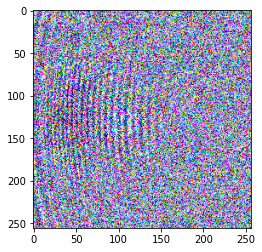

In [ ]:
plt.imshow(noise_img[2])

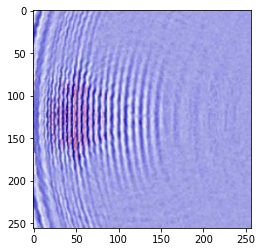

In [ ]:
plt.imshow(add_noise[2])

In [ ]:
 plt.figure(figsize=(45, 900))
 for i in range(batch_size_noise):
  ax = plt.subplot(470, 10, i + 1)
  plt.imshow(tmp_numpy_image[i])
  plt.title(class_names[labels[i]])

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
y = np.concatenate([y for x, y in val_ds], axis=0)
act_label = y
#act_label

In [ ]:
#result = loaded_model.predict(val_ds)

pred_label = dict()
size = result.shape

for i in range(size[0]):
  pred_label[i] = np.argmax(result[i])

#pred_label

In [ ]:
# Add additive noise to validation dataset

noise_img = []
img_to_numpy = []
add_noise = []
scale = 50
noise_level = 0.05*20
for images, labels in validation_ds.take(1):
  for i in range(batch_size_noise):
    img_to_numpy.append(np.array(images[i]))
    add_noise.append(img_to_numpy[i].copy())
    add_noise[i] = add_noise[i].astype('uint8') 

    noise_img.append(random_noise(add_noise[i], mode='s&p', seed=123, clip=True, amount=noise_level))

    #np.putmask(noise_img[i], noise_img[i] < 0, 0)
    #np.putmask(noise_img[i], noise_img[i] > 255, 255)
    
    #noise_img[i] = noise_img[i].astype('uint8') 

tmp_numpy_image = noise_img

In [ ]:
#tmp_numpy_image_val = img_to_numpy[0].reshape(-1, img_size, img_size, 3)

#noise_result = loaded_model.predict(tmp_numpy_image_val)

noise_pred_label = dict()
noise_result = dict()
size = batch_size_noise

for i in range(size):
  tmp_numpy_image_val = img_to_numpy[i].reshape(-1, img_size, img_size, 3)
  noise_result[i] = loaded_model.predict(tmp_numpy_image_val)
  noise_pred_label[i] = np.argmax(noise_result[i]) 

#noise_pred_label

In [ ]:
# No flaws accuracy evaluation

n = 0 # 0 for no flaws
size = act_label.shape[0]
act_counter = 0
pred_counter = 0
noise_counter = 0

#scale_ptg = (scale/255)*100 # For multiplicative noise
scale_ptg = (noise_level/1)*100 # For additive noise

for i in range(size):
  if act_label[i] == n:
    act_counter += 1

for i in range(size):
  if act_label[i] == n and pred_label[i] == n:
    pred_counter += 1

for i in range(size):
  if act_label[i] == n and noise_pred_label[i] == n:
    noise_counter += 1

no_flaw_acc = (pred_counter/act_counter)*100
no_flaw_acc_noise = (noise_counter/act_counter)*100

print(f"{no_flaw_acc}% No flaw accuracy without addition of noise")
print(f"{no_flaw_acc_noise}% No flaw accuracy with addition of {scale_ptg:.1f}% noise")

99.63503649635037% No flaw accuracy without addition of noise
63.138686131386855% No flaw accuracy with addition of 100.0% noise


In [ ]:
# 1mm Flaw classification accuracy evaluation

n = 1 # 1 for 1mm flaws
size = act_label.shape[0]
act_counter = 0
pred_counter = 0
noise_counter = 0

#scale_ptg = (scale/255)*100 # For multiplicative noise
scale_ptg = (noise_level/1)*100 # For additive noise

for i in range(size):
  if act_label[i] == n:
    act_counter += 1

for i in range(size):
  if act_label[i] == n and pred_label[i] == n:
    pred_counter += 1

for i in range(size):
  if act_label[i] == n and noise_pred_label[i] == n:
    noise_counter += 1

flaw_acc_1mm = (pred_counter/act_counter)*100
flaw_acc_noise_1mm = (noise_counter/act_counter)*100

print(f"{flaw_acc_1mm}% 1mm Flaw classification accuracy without addition of noise")
print(f"{flaw_acc_noise_1mm}% 1mm Flaw classification accuracy with addition of {scale_ptg:.1f}% noise")

100.0% 1mm Flaw classification accuracy without addition of noise
13.333333333333334% 1mm Flaw classification accuracy with addition of 100.0% noise


In [ ]:
# 3mm Flaw classification accuracy evaluation

n = 2 # 2 for 3mm flaws
size = act_label.shape[0]
act_counter = 0
pred_counter = 0
noise_counter = 0

#scale_ptg = (scale/255)*100 # For multiplicative noise
scale_ptg = (noise_level/1)*100 # For additive noise

for i in range(size):
  if act_label[i] == n:
    act_counter += 1

for i in range(size):
  if act_label[i] == n and pred_label[i] == n:
    pred_counter += 1

for i in range(size):
  if act_label[i] == n and noise_pred_label[i] == n:
    noise_counter += 1

flaw_acc_3mm = (pred_counter/act_counter)*100
flaw_acc_noise_3mm = (noise_counter/act_counter)*100

print(f"{flaw_acc_3mm}% 3mm Flaw classification accuracy without addition of noise")
print(f"{flaw_acc_noise_3mm}% 3mm Flaw classification accuracy with addition of {scale_ptg:.1f}% noise")

57.77777777777777% 3mm Flaw classification accuracy without addition of noise
11.11111111111111% 3mm Flaw classification accuracy with addition of 100.0% noise


In [ ]:
# 5mm Flaw classification accuracy evaluation

n = 3 # 3 for 5mm flaws
size = act_label.shape[0]
act_counter = 0
pred_counter = 0
noise_counter = 0

#scale_ptg = (scale/255)*100 # For multiplicative noise
scale_ptg = (noise_level/1)*100 # For additive noise

for i in range(size):
  if act_label[i] == n:
    act_counter += 1

for i in range(size):
  if act_label[i] == n and pred_label[i] == n:
    pred_counter += 1

for i in range(size):
  if act_label[i] == n and noise_pred_label[i] == n:
    noise_counter += 1

flaw_acc_5mm = (pred_counter/act_counter)*100
flaw_acc_noise_5mm = (noise_counter/act_counter)*100

print(f"{flaw_acc_5mm}% 5mm Flaw classification accuracy without addition of noise")
print(f"{flaw_acc_noise_5mm}% 5mm Flaw classification accuracy with addition of {scale_ptg:.1f}% noise")

97.5% 5mm Flaw classification accuracy without addition of noise
23.75% 5mm Flaw classification accuracy with addition of 100.0% noise


In [ ]:
# 10mm Flaw classification accuracy evaluation

n = 4 # 4 for 10mm flaws
size = act_label.shape[0]
act_counter = 0
pred_counter = 0
noise_counter = 0

#scale_ptg = (scale/255)*100 # For multiplicative noise
scale_ptg = (noise_level/1)*100 # For additive noise

for i in range(size):
  if act_label[i] == n:
    act_counter += 1

for i in range(size):
  if act_label[i] == n and pred_label[i] == n:
    pred_counter += 1

for i in range(size):
  if act_label[i] == n and noise_pred_label[i] == n:
    noise_counter += 1

flaw_acc_10mm = (pred_counter/act_counter)*100
flaw_acc_noise_10mm = (noise_counter/act_counter)*100

print(f"{flaw_acc_10mm}% 10mm Flaw classification accuracy without addition of noise")
print(f"{flaw_acc_noise_10mm}% 10mm Flaw classification accuracy with addition of {scale_ptg:.1f}% noise")

88.46153846153845% 10mm Flaw classification accuracy without addition of noise
0.0% 10mm Flaw classification accuracy with addition of 100.0% noise


In [ ]:
# Save 

from google.colab import drive
drive.mount('/content/drive')

with open('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/Arrays/result1.txt', 'wb') as f: # result for model predicted labels
    np.save(f, result)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Load

result = np.load('/content/drive/MyDrive/Colab Notebooks/FlawSizeClassification/Arrays/result1.txt')